In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import SGDRegressor


df = pd.read_csv('Data/house_prices.csv')

df

df = df.drop(['id', 'date'], axis=1)

In [2]:
print(df.isnull().sum())

price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64


In [3]:
duplicate_df = df[df.duplicated()]
print("Number of duplicate rows", duplicate_df.shape)

df = df.drop_duplicates()



Number of duplicate rows (5, 19)


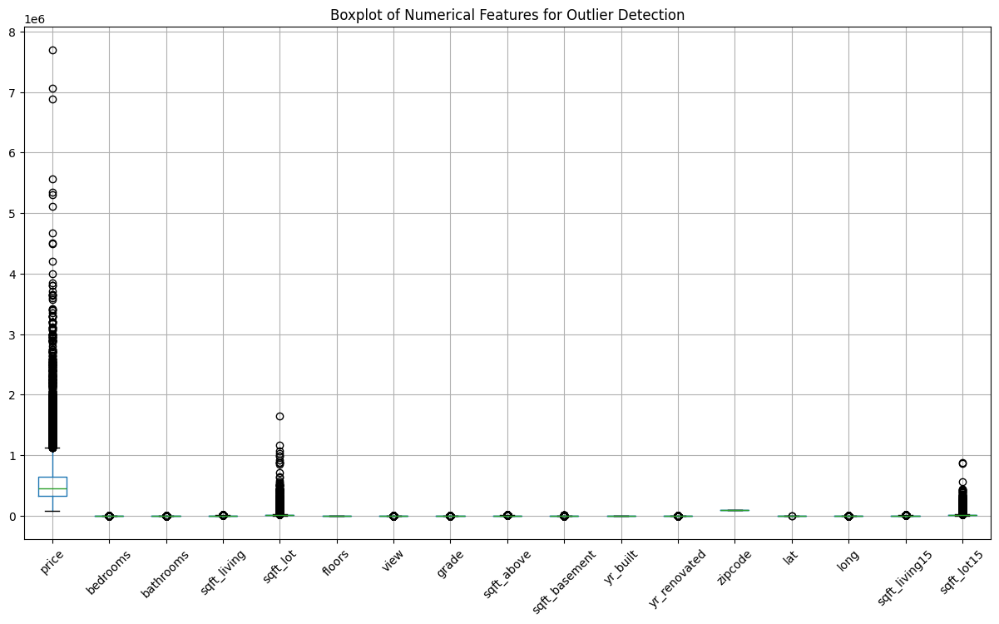

In [4]:
numerical_columns = ["pm2.5", "pm10", "no2", "so2", "co", "proximity_to_industrial_areas", "population_density", "air_quality"]

plt.figure(figsize=(15, 8))
df.boxplot(rot=45)
plt.title("Boxplot of Numerical Features for Outlier Detection")
plt.show()

In [5]:
from sklearn.preprocessing import LabelEncoder

le_waterfront = LabelEncoder()
le_condition = LabelEncoder()

df['waterfront_en'] = le_waterfront.fit_transform(df['waterfront'])
df['condition_en'] = le_condition.fit_transform(df['condition'])

print(dict(enumerate(le_waterfront.classes_)))
print(dict(enumerate(le_condition.classes_)))


{0: 'N', 1: 'Y'}
{0: 'Average', 1: 'Fair', 2: 'Good', 3: 'Poor', 4: 'Very Good'}


In [6]:
df = df.drop(['waterfront', 'condition'], axis=1)

df

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,waterfront_en,condition_en
0,221900.0,3,1.00,1180,5650,1.0,0,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,0,0
1,538000.0,3,2.25,2570,7242,2.0,0,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,0,0
2,180000.0,2,1.00,770,10000,1.0,0,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,0,0
3,604000.0,4,3.00,1960,5000,1.0,0,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,0,4
4,510000.0,3,2.00,1680,8080,1.0,0,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,360000.0,3,2.50,1530,1131,3.0,0,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509,0,0
21609,400000.0,4,2.50,2310,5813,2.0,0,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200,0,0
21610,402101.0,2,0.75,1020,1350,2.0,0,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007,0,0
21611,400000.0,3,2.50,1600,2388,2.0,0,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287,0,0


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21608 entries, 0 to 21612
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   price          21608 non-null  float64
 1   bedrooms       21608 non-null  int64  
 2   bathrooms      21608 non-null  float64
 3   sqft_living    21608 non-null  int64  
 4   sqft_lot       21608 non-null  int64  
 5   floors         21608 non-null  float64
 6   view           21608 non-null  int64  
 7   grade          21608 non-null  int64  
 8   sqft_above     21608 non-null  int64  
 9   sqft_basement  21608 non-null  int64  
 10  yr_built       21608 non-null  int64  
 11  yr_renovated   21608 non-null  int64  
 12  zipcode        21608 non-null  int64  
 13  lat            21608 non-null  float64
 14  long           21608 non-null  float64
 15  sqft_living15  21608 non-null  int64  
 16  sqft_lot15     21608 non-null  int64  
 17  waterfront_en  21608 non-null  int64  
 18  condition_e

In [8]:
import numpy as np
import pandas as pd

def remove_outliers_iqr(df):
    numeric_columns = df.select_dtypes(include=[np.number]).columns  # เลือกเฉพาะคอลัมน์ตัวเลข
    Q1 = df[numeric_columns].quantile(0.25)
    Q3 = df[numeric_columns].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    df_cleaned = df[~((df[numeric_columns] < lower_bound) | (df[numeric_columns] > upper_bound)).any(axis=1)]

    return df_cleaned

df_cleaned = remove_outliers_iqr(df)

original_size = df.shape[0]
cleaned_size = df_cleaned.shape[0]

original_size, cleaned_size


(21608, 14942)

In [9]:
df_cleaned

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,waterfront_en,condition_en
0,221900.0,3,1.00,1180,5650,1.0,0,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,0,0
2,180000.0,2,1.00,770,10000,1.0,0,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,0,0
3,604000.0,4,3.00,1960,5000,1.0,0,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,0,4
4,510000.0,3,2.00,1680,8080,1.0,0,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,0,0
6,257500.0,3,2.25,1715,6819,2.0,0,7,1715,0,1995,0,98003,47.3097,-122.327,2238,6819,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,360000.0,3,2.50,1530,1131,3.0,0,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509,0,0
21609,400000.0,4,2.50,2310,5813,2.0,0,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200,0,0
21610,402101.0,2,0.75,1020,1350,2.0,0,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007,0,0
21611,400000.0,3,2.50,1600,2388,2.0,0,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287,0,0


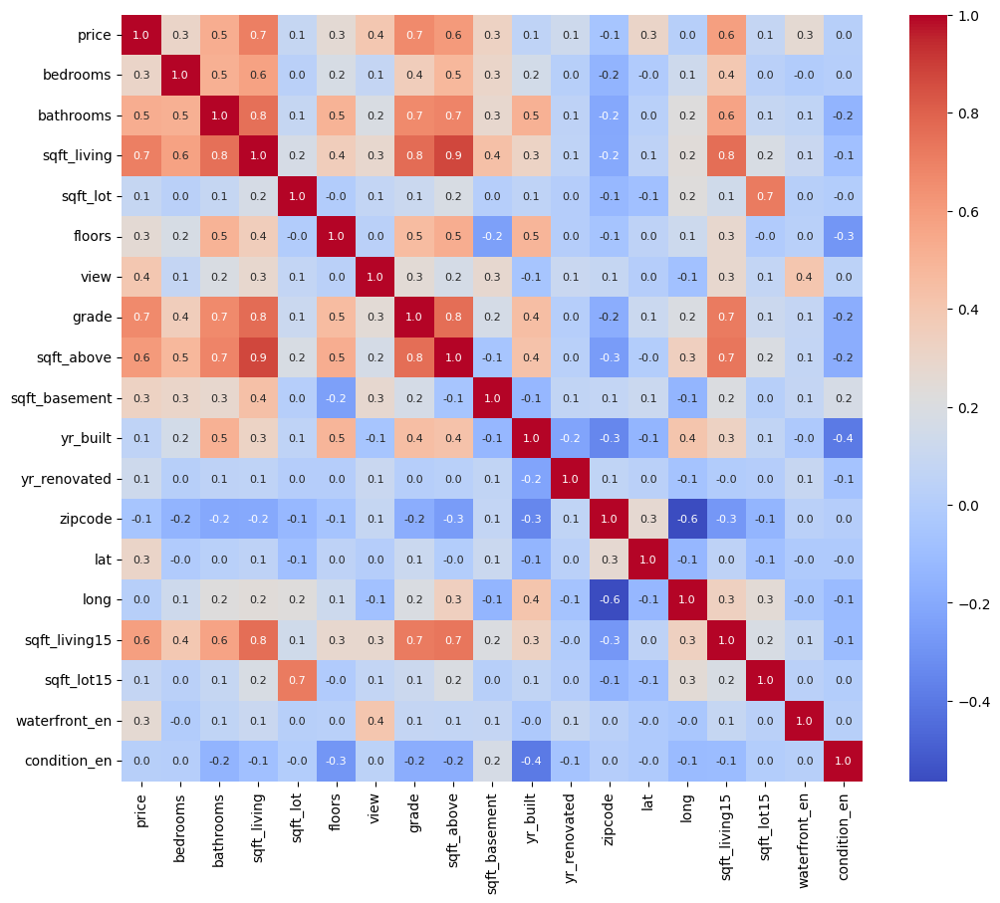

In [10]:
# Correlation matrix
corr_matrix = df.corr()
plt.figure(figsize=(12, 10))  # Adjust the width and height as needed

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm',fmt=".1f", annot_kws={"size": 8})
plt.show()

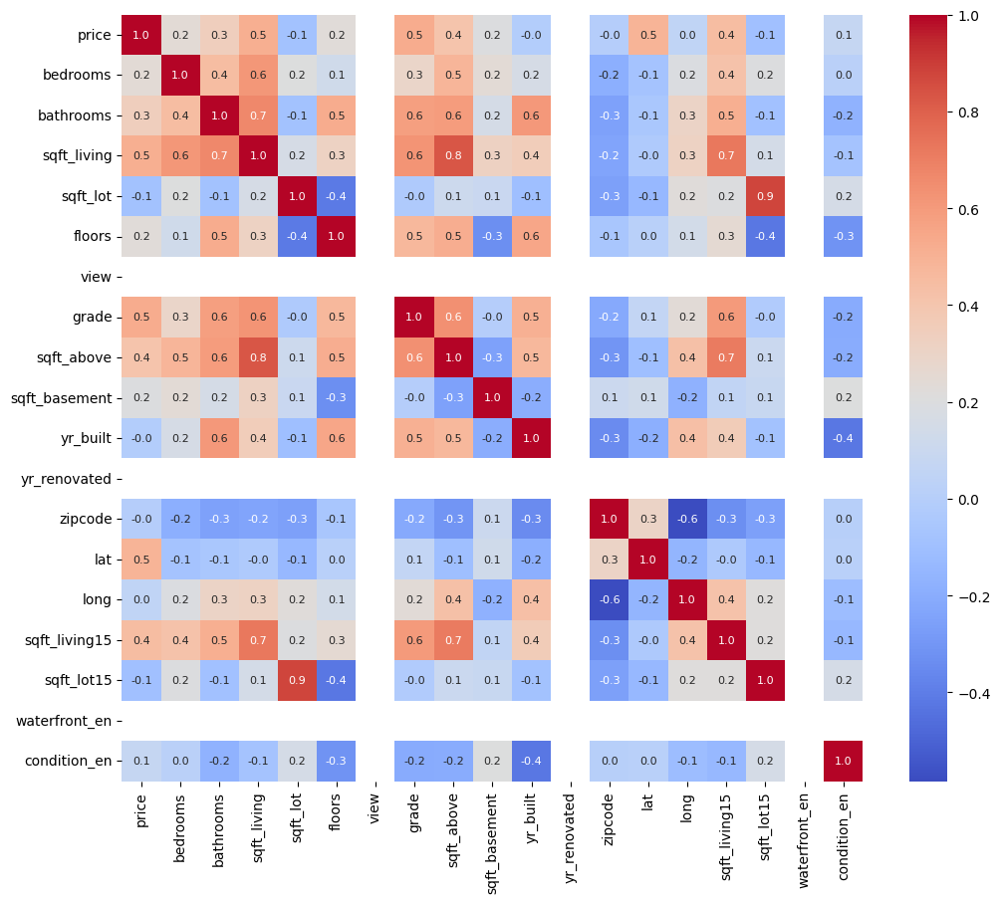

In [11]:
# Correlation matrix
corr_matrix = df_cleaned.corr()
plt.figure(figsize=(12, 10))  # Adjust the width and height as needed

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm',fmt=".1f", annot_kws={"size": 8})
plt.show()

C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\pandas\plotting\_matplotlib\misc.py:100: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set_xlim(boundaries_list[j])
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\pandas\plotting\_matplotlib\misc.py:101: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(boundaries_list[i])
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\pandas\plotting\_matplotlib\misc.py:91: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax.set_xlim(boundaries_list[i])


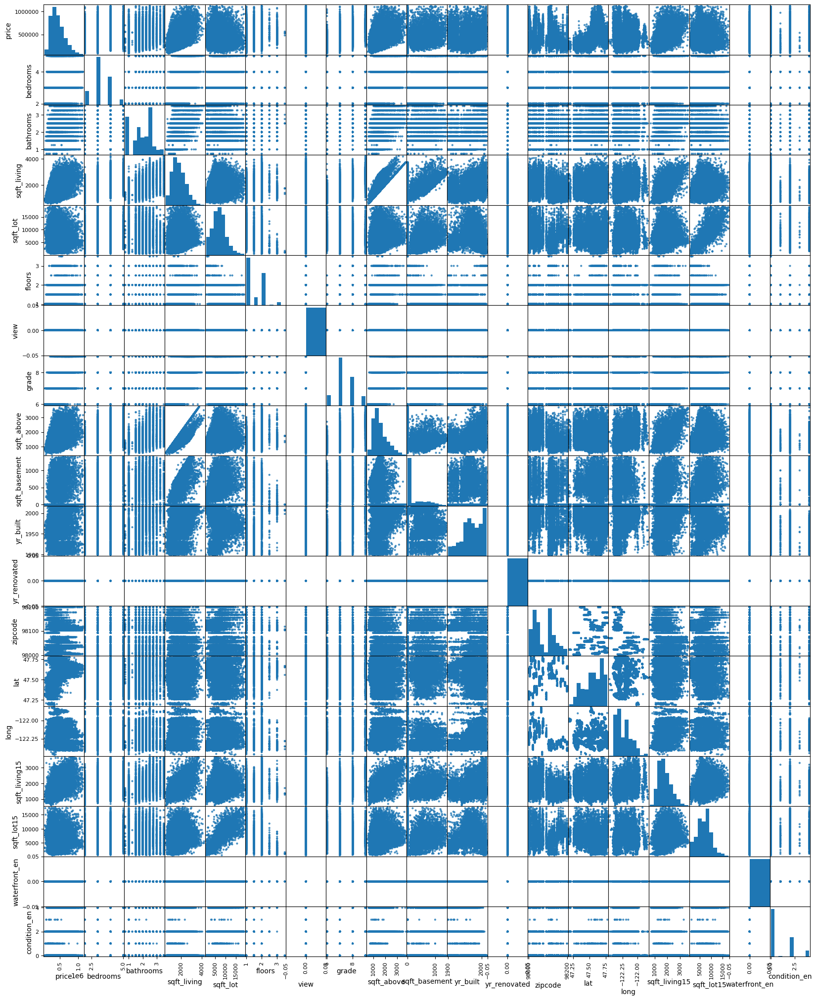

In [12]:
from pandas.plotting import scatter_matrix
clean_data = df_cleaned.apply(pd.to_numeric, errors='coerce')
scatter_matrix(clean_data, figsize=(20, 25), alpha=0.8, diagonal='hist')
plt.show()

In [13]:
#df['sqft_living', 'grade', 'sqft_above', 'sqft_living15', 'lat']
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

x1 = df_cleaned['sqft_living']
x2 = df_cleaned['grade']
x3 = df_cleaned['sqft_above']
x4 = df_cleaned['sqft_living15']
x5 = df_cleaned['lat']
X = np.column_stack((x1, x2, x3, x4, x5))
y = df_cleaned['price']

X_scaled = scaler.fit_transform(X)

In [14]:
# ต้องโหลดไลบรารีใหม่หลังจาก state ถูก reset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import SGDRegressor

# ตั้งค่าตัวเรียนรู้แบบ SGD
sgd = SGDRegressor(max_iter=1, learning_rate='constant', eta0=1e-8, warm_start=True)

# เก็บค่าพารามิเตอร์ในแต่ละ epoch และสมการทุก ๆ 100 รอบ
m1_vals, m2_vals, m3_vals, m4_vals, m5_vals, mse_values, equations_sse = [], [], [], [], [], [], []

# เรียนรู้แบบ SGD ทีละรอบและบันทึกค่าพารามิเตอร์และ error
for epoch in range(20001):  # รัน 2000 epochs
    sgd.fit(X_scaled, y)
    m1, m2, m3, m4, m5 = sgd.coef_
    c = sgd.intercept_[0]

    y_pred = sgd.predict(X_scaled)
    mse = np.mean((y - y_pred) ** 2)  # คำนวณค่า MSE

    m1_vals.append(m1)
    m2_vals.append(m2)
    m3_vals.append(m3)
    m4_vals.append(m4)
    m5_vals.append(m5)
    mse_values.append(mse)

    if epoch % 2000 == 0:
        equations_sse.append(f"Epoch {epoch}: y = {m1:.4f}x1 + {m2:.4f}x2 + {m3:.4f}x3 + {m4:.4f}x4 + {m5:.4f}x5 + {c:.4f}, MSE = {mse:.4f}")

# Plot ค่า MSE ในแต่ละ epoch
plt.figure(figsize=(10, 5))
plt.plot(range(20001), mse_values, label="MSE over epochs", color="blue")
plt.xlabel("Epochs")
plt.ylabel("Mean Squared Error (MSE)")
plt.title("MSE over Training Epochs")
plt.legend()
plt.show()

# แสดงสมการที่บันทึกไว้ทุก 100 epochs พร้อมค่า MSE
equations_sse


C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fi

KeyboardInterrupt: 

C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fi

Early stopping at epoch 78436 with MSE 13947210492.500319


C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
C:\Users\Pond0\AppData\Roaming\Python\Python312\site-packages\sklearn\linear_model\_stochastic_gradient.py:1608: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fi

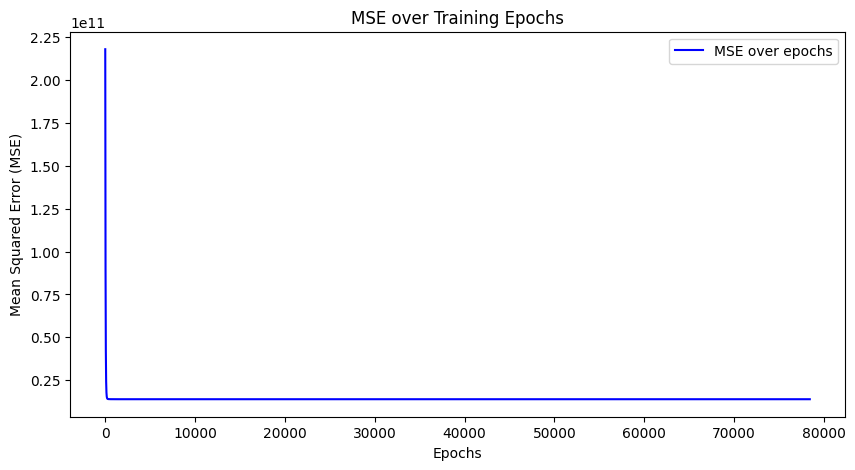

['Epoch 0: y = 1355.6705x1 + 1393.7005x2 + 1070.7859x3 + 1175.9546x4 + 1311.9223x5 + 6502.1429, MSE = 217981831344.0518']

In [ ]:
# โหลดไลบรารีใหม่หลังจาก state ถูก reset
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import SGDRegressor

# ตั้งค่าตัวเรียนรู้แบบ SGD
sgd = SGDRegressor(max_iter=1, learning_rate='constant', eta0=1e-6, warm_start=True)

# เก็บค่าพารามิเตอร์ในแต่ละ epoch และสมการทุก ๆ 20000 รอบ
m1_vals, m2_vals, m3_vals, m4_vals, m5_vals, mse_values, equations_sse = [], [], [], [], [], [], []

# กำหนดค่าเงื่อนไขการหยุด (Early Stopping)
tolerance = 1e-6
max_epochs = 1000001

# เรียนรู้แบบ SGD ทีละรอบและบันทึกค่าพารามิเตอร์และ error
for epoch in range(max_epochs):  
    sgd.fit(X_scaled, y)
    m1, m2, m3, m4, m5 = sgd.coef_
    c = sgd.intercept_[0]

    y_pred = sgd.predict(X_scaled)
    mse = np.mean((y - y_pred) ** 2)  # คำนวณค่า MSE

    m1_vals.append(m1)
    m2_vals.append(m2)
    m3_vals.append(m3)
    m4_vals.append(m4)
    m5_vals.append(m5)
    mse_values.append(mse)

    # บันทึกสมการทุก ๆ 20000 epochs
    if epoch % 100000 == 0:
        equations_sse.append(f"Epoch {epoch}: y = {m1:.4f}x1 + {m2:.4f}x2 + {m3:.4f}x3 + {m4:.4f}x4 + {m5:.4f}x5 + {c:.4f}, MSE = {mse:.4f}")
    
    # ตรวจสอบเงื่อนไขการหยุด (Early Stopping)
    if epoch > 0 and abs(mse_values[-1] - mse_values[-2]) < tolerance:
        print(f"Early stopping at epoch {epoch} with MSE {mse:.6f}")
        break

# Plot ค่า MSE ในแต่ละ epoch
plt.figure(figsize=(10, 5))
plt.plot(range(len(mse_values)), mse_values, label="MSE over epochs", color="blue")
plt.xlabel("Epochs")
plt.ylabel("Mean Squared Error (MSE)")
plt.title("MSE over Training Epochs")
plt.legend()
plt.show()

# แสดงสมการที่บันทึกไว้ทุก ๆ 20000 epochs พร้อมค่า MSE
equations_sse


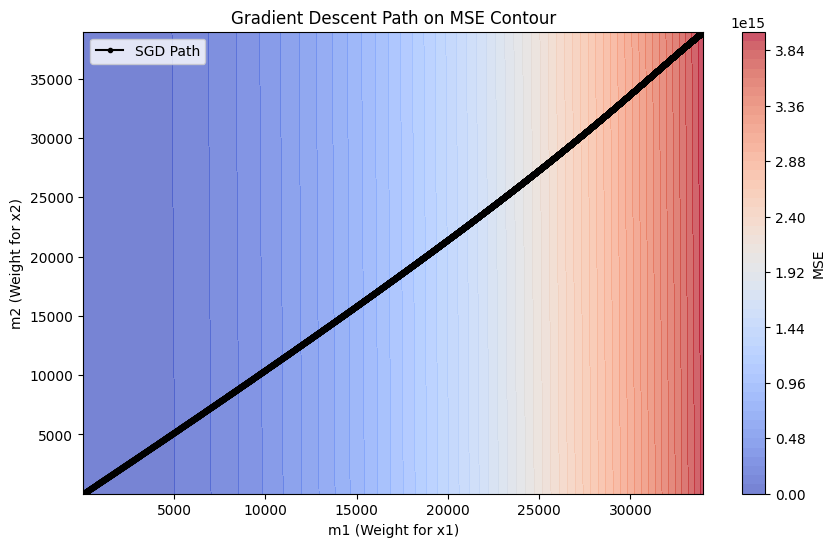

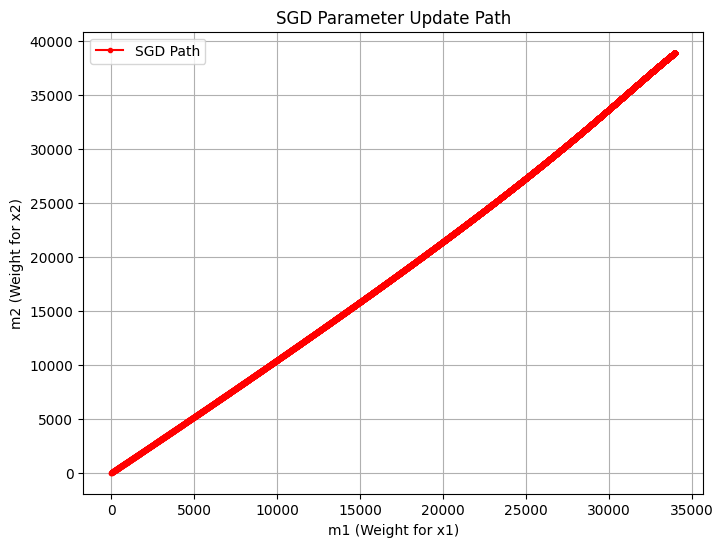

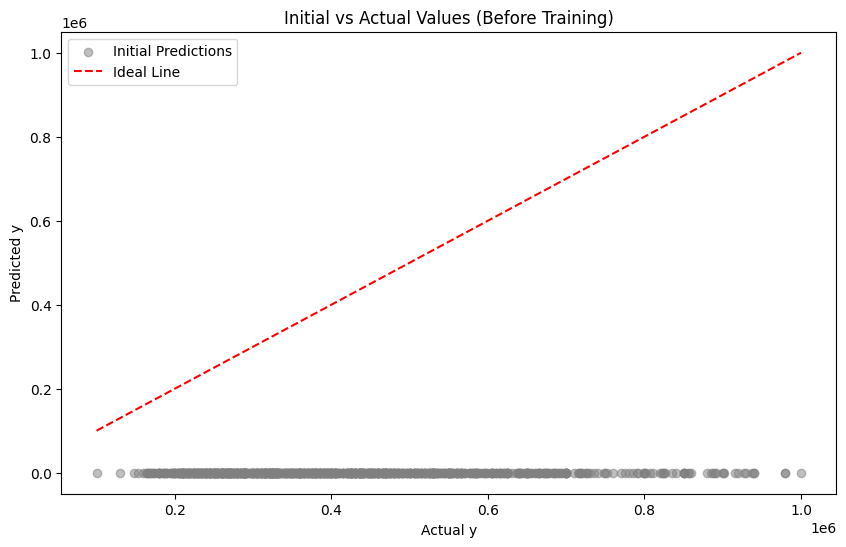

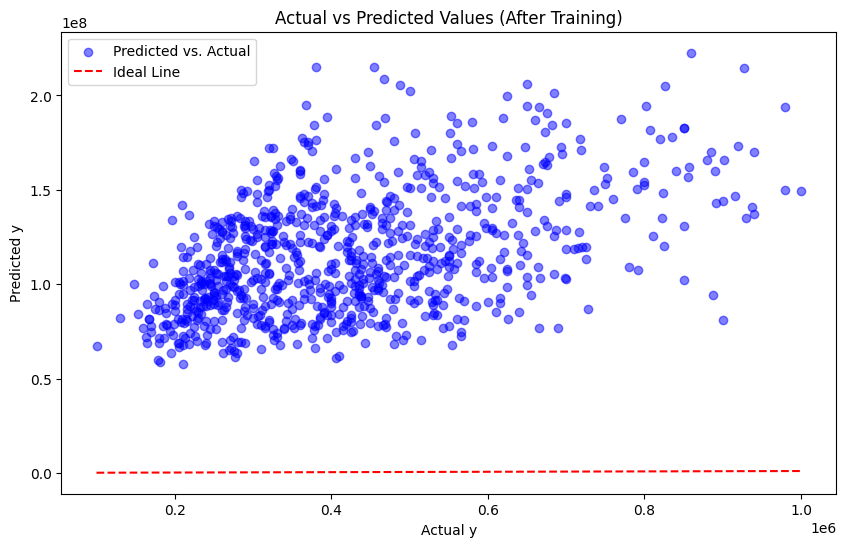

In [ ]:
# สร้างกราฟ Contour และเส้นทางของ Gradient Descent

# เลือกเฉพาะสองพารามิเตอร์แรกเพื่อให้สามารถแสดงผลเป็น 2D ได้
m1_vals_subset = np.array(m1_vals)
m2_vals_subset = np.array(m2_vals)

# คำนวณ Loss Function บนกริดของค่าพารามิเตอร์
m1_range = np.linspace(min(m1_vals_subset), max(m1_vals_subset), 100)
m2_range = np.linspace(min(m2_vals_subset), max(m2_vals_subset), 100)
M1, M2 = np.meshgrid(m1_range, m2_range)
MSE_grid = np.zeros_like(M1)

for i in range(M1.shape[0]):
    for j in range(M1.shape[1]):
        coef = np.array([M1[i, j], M2[i, j], 4, 5, 6])  # ใช้ค่าที่ใกล้เคียงของพารามิเตอร์อื่น ๆ
        y_pred_grid = X @ coef + 5  # Intercept คงที่
        MSE_grid[i, j] = np.mean((y - y_pred_grid) ** 2)

# Plot Contour
plt.figure(figsize=(10, 6))
plt.contourf(M1, M2, MSE_grid, levels=50, cmap="coolwarm", alpha=0.7)
plt.colorbar(label="MSE")
plt.plot(m1_vals_subset, m2_vals_subset, marker="o", color="black", linestyle="-", markersize=3, label="SGD Path")
plt.xlabel("m1 (Weight for x1)")
plt.ylabel("m2 (Weight for x2)")
plt.title("Gradient Descent Path on MSE Contour")
plt.legend()
plt.show()

# Plot เส้นทางของ Gradient Descent ใน 2D Space
plt.figure(figsize=(8, 6))
plt.plot(m1_vals_subset, m2_vals_subset, marker="o", color="red", linestyle="-", markersize=3, label="SGD Path")
plt.xlabel("m1 (Weight for x1)")
plt.ylabel("m2 (Weight for x2)")
plt.title("SGD Parameter Update Path")
plt.legend()
plt.grid(True)
plt.show()

# Plot Linear Graph ก่อนทำการเทรน
plt.figure(figsize=(10, 6))
initial_predictions = np.zeros_like(y)  # ค่าที่พยากรณ์เริ่มต้นก่อนเทรน (เป็นศูนย์ทั้งหมด)
plt.scatter(y, initial_predictions, alpha=0.5, color="gray", label="Initial Predictions")
plt.plot([min(y), max(y)], [min(y), max(y)], color="red", linestyle="--", label="Ideal Line")
plt.xlabel("Actual y")
plt.ylabel("Predicted y")
plt.title("Initial vs Actual Values (Before Training)")
plt.legend()
plt.show()

# แสดงกราฟ Linear Graph หลังจากเทรนเสร็จ
plt.figure(figsize=(10, 6))
plt.scatter(y, sgd.predict(X), alpha=0.5, color="blue", label="Predicted vs. Actual")
plt.plot([min(y), max(y)], [min(y), max(y)], color="red", linestyle="--", label="Ideal Line")
plt.xlabel("Actual y")
plt.ylabel("Predicted y")
plt.title("Actual vs Predicted Values (After Training)")
plt.legend()
plt.show()


In [ ]:
'''# กำหนดค่าตัวแปรตามที่ร้องขอ
x1 = df_cleaned['sqft_living']
x2 = df_cleaned['grade']
x3 = df_cleaned['sqft_above']
x4 = df_cleaned['sqft_living15']
x5 = df_cleaned['lat']
X = np.column_stack((x1, x2, x3, x4, x5))
y = df_cleaned['price']

# คำนวณค่าพยากรณ์
y_hat = 2.9651*x1 + 2.0169*x2 + 3.9714*x3 + 4.9900*x4 + 5.9449*x5 + 5.3598

mse_total = ((y - y_hat)**2)

df_result = pd.DataFrame({
    'sqft_living': x1.round(2),
    'grade': x2,
    'sqft_above': x3.round(2),
    'sqft_living15': x4.round(2),
    'lat': x5.round(2),
    'price_actual': y.round(2),
    'price_predicted': y_hat.round(2),a
    'MSE_total': round(mse_total, 2)
})

df_result'''

"# กำหนดค่าตัวแปรตามที่ร้องขอ\nx1 = df_cleaned['sqft_living']\nx2 = df_cleaned['grade']\nx3 = df_cleaned['sqft_above']\nx4 = df_cleaned['sqft_living15']\nx5 = df_cleaned['lat']\nX = np.column_stack((x1, x2, x3, x4, x5))\ny = df_cleaned['price']\n\n# คำนวณค่าพยากรณ์\ny_hat = 2.9651*x1 + 2.0169*x2 + 3.9714*x3 + 4.9900*x4 + 5.9449*x5 + 5.3598\n\nmse_total = ((y - y_hat)**2)\n\ndf_result = pd.DataFrame({\n    'sqft_living': x1.round(2),\n    'grade': x2,\n    'sqft_above': x3.round(2),\n    'sqft_living15': x4.round(2),\n    'lat': x5.round(2),\n    'price_actual': y.round(2),\n    'price_predicted': y_hat.round(2),a\n    'MSE_total': round(mse_total, 2)\n})\n\ndf_result"